In [1]:
#packages to install
# !pip install pivottablejs
# !pip install bar_chart_race
# !pip install ffmpeg-python
# !pip install jupyter-datatables -need work
# !pip install calmap

In [2]:
import warnings
warnings.filterwarnings("ignore")

In [3]:
# Importing Packages
import pandas as pd
import missingno as msno
import matplotlib.pyplot as plt
import plotly.express as px
import bar_chart_race as bcr
import seaborn as sns
from scipy.stats import ttest_ind, norm
from IPython.display import Video
import plotly.graph_objects as go
import calmap
import numpy as np
from matplotlib.patches import Rectangle
from matplotlib.collections import PatchCollection

In [4]:
Acc_df=pd.read_csv('DfTRoadSafety_Accidents_2012.csv')
Acc_df

,Accident_Index,Location_Easting_OSGR,Location_Northing_OSGR,Longitude,Latitude,Police_Force,Accident_Severity,Number_of_Vehicles,Number_of_Casualties,Date,...,Pedestrian_Crossing-Human_Control,Pedestrian_Crossing-Physical_Facilities,Light_Conditions,Weather_Conditions,Road_Surface_Conditions,Special_Conditions_at_Site,Carriageway_Hazards,Urban_or_Rural_Area,Did_Police_Officer_Attend_Scene_of_Accident,LSOA_of_Accident_Location
0,201201BS70001,527200,178760,-0.169101,51.493429,1,3,2,1,19/01/2012,...,0,5,4,1,1,0,0,1,1,E01002821
1,201201BS70002,524930,181430,-0.200838,51.517931,1,3,2,1,04/01/2012,...,0,0,4,1,1,0,0,1,1,E01004760
2,201201BS70003,525860,178080,-0.188636,51.487618,1,3,2,1,10/01/2012,...,0,4,1,1,1,0,0,1,1,E01002893
3,201201BS70004,524980,181030,-0.200259,51.514325,1,3,1,1,18/01/2012,...,0,0,1,1,1,0,0,1,1,E01002886
4,201201BS70005,526170,179200,-0.183773,51.497614,1,3,1,1,17/01/2012,...,0,0,4,1,1,0,0,1,1,E01002890
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145566,2012984140212,303770,610870,-3.520404,55.382366,98,3,2,1,06/12/2012,...,0,0,1,2,3,0,0,2,1,NaN
145567,2012984141412,337350,591392,-2.986151,55.212806,98,3,1,1,20/12/2012,...,0,0,6,2,5,0,0,2,1,NaN
145568,2012984141912,303700,611250,-3.521639,55.385766,98,3,1,1,22/12/2012,...,0,0,1,5,2,0,0,2,1,NaN
145569,2012984142512,309250,581750,-3.424552,55.121821,98,3,1,2,25/12/2012,...,0,0,1,1,2,0,0,2,1,NaN


In [5]:
Acc_df = Acc_df.rename(columns={'Local_Authority_(District)': 'local_auth_district', 'Local_Authority_(Highway)': 'local_auth_highway','1st_Road_Class':'first_Road_class',
                                  '2nd_Road_Class':'second_Road_class','Pedestrian_Crossing-Human_Control':'Ped_cross_Hum_cntrl',
                                'Pedestrian_Crossing-Physical_Facilities':'Ped_cross_Phy_Fac','Did_Police_Officer_Attend_Scene_of_Accident':'Police_Attend'})
Acc_df.columns

Index(['Accident_Index', 'Location_Easting_OSGR', 'Location_Northing_OSGR',
       'Longitude', 'Latitude', 'Police_Force', 'Accident_Severity',
       'Number_of_Vehicles', 'Number_of_Casualties', 'Date', 'Day_of_Week',
       'Time', 'local_auth_district', 'local_auth_highway', 'first_Road_class',
       '1st_Road_Number', 'Road_Type', 'Speed_limit', 'Junction_Detail',
       'Junction_Control', 'second_Road_class', '2nd_Road_Number',
       'Ped_cross_Hum_cntrl', 'Ped_cross_Phy_Fac', 'Light_Conditions',
       'Weather_Conditions', 'Road_Surface_Conditions',
       'Special_Conditions_at_Site', 'Carriageway_Hazards',
       'Urban_or_Rural_Area', 'Police_Attend', 'LSOA_of_Accident_Location'],
      dtype='object')

In [6]:
Acc_df1=Acc_df.copy() # for visulizations

### Columns Description

Accident_Index: Unique ID of the accident

Location_Easting_OSGR: East coordinate of the accident position, using the Ordnance Survey Grid Reference

Location_Northing_OSGR: North coordinate of the location of the accident, using the Ordnance Survey Grid Reference

Longitude: Longitude of the accident location

Latitude: Latitude of the accident location

Police_Force: Police force responsible for handling the accident

Accident_Severity: Severity of the accident

Number_of_Vehicles: Number of vehicles involved in the accident

Number_of_Casualties: Number of people injured or killed in the accident

Date: Date of the accident

Day_of_Week: Day of the week of the accident (1 = Sunday, 2 = Monday, ..., 7 = Saturday)

Time: Time of the accident

local_auth_district-LocalAuthority(District): Local authority responsible for the area where the accident took place

local_auth_highway-LocalAuthority(Highway): Local authority responsible for the road where the accident took place

first_Road_class: Class of the first road involved in the accident (1 = highway, 2 = A road, 3 = B road, 4 = other road)

1st_Road_Number: Number of the first road involved in the accident

Road_Type: Type of road where the accident occurred (Roundabout, One way street, Dual carriageway, Single carriageway)

Speed_limit: Speed limit of the road where the accident occurred

Junction_Detail: Detail of the junction where the accident occurred

Junction_Control: Type of control of the junction where the accident occurred

second_Road_class: Class of the second road involved in the accident

2nd_Road_Number: Number of the second road involved in the accident

Ped_cross_Hum_cntrl:Pedestrian_Crossing-Human_Control: Type of human control for the crosswalks where the accident occurred

Ped_cross_Phy_Fac: Pedestrian_Crossing-Physical_Facilities: Type of physical facility for the crosswalk where the accident occurred

Light_Conditions: Lighting conditions where the accident occurred

Weather_Conditions: Weather conditions where the accident occurred

Road_Surface_Conditions: Road surface conditions where the accident occurred

Special_Conditions_at_Site: Special conditions at the site where the accident occurred

Carriageway_Hazards: Hazards on the roadway where the accident occurred

Urban_or_Rural_Area: Area where the accident occurred(Urban or rural)

Police_Attend: Indicates if the Police attended the scene or not

## Column Mapping

In [7]:
import pandas as pd

excel_file_path = 'Road-Accident-Safety-Data-Guide.xls.xlsx'

dfs = pd.read_excel(excel_file_path, sheet_name=None)

Accident_Severity = dfs['Accident Severity'] 
Police_Force = dfs['Police Force']
Day_of_Week = dfs['Day of Week']
Local_Authority_District = dfs['Local Authority (District)']
Local_Authority_Highway = dfs['Local Authority (Highway)']
first_Road_class=dfs['1st Road Class']
Road_Type = dfs['Road Type']
Junction_Detail = dfs['Junction Detail']
Junction_Control = dfs['Junction Control']
second_Road_Class=dfs['2nd Road Class']
Pedestrian_Crossing_Human_Control=dfs['Ped Cross - Human']
Pedestrian_Crossing_Physical_Facilities=dfs['Ped Cross - Physical']
Light_Conditions = dfs['Light Conditions']
Weather_Conditions = dfs['Weather']
Road_Surface_Conditions = dfs['Road Surface']
Special_Conditions_at_Site = dfs['Special Conditions at Site']
Carriageway_Hazards=dfs['Carriageway Hazards']
Urban_or_Rural_Area = dfs['Urban Rural']
Did_Police_Officer_Attend_Scene_of_Accident = dfs['Police Officer Attend']

In [8]:
Accident_Severity_dict=Accident_Severity.set_index('code')['label'].to_dict()
Police_Force_dict=Police_Force.set_index('code')['label'].to_dict()
Day_of_Week_dict=Day_of_Week.set_index('code')['label'].to_dict()
Local_Authority_District_dict=Local_Authority_District.set_index('code')['label'].to_dict()
Local_Authority_Highway_dict=Local_Authority_Highway.set_index('Code')['Label'].to_dict()
first_Road_class_dict=first_Road_class.set_index('code')['label'].to_dict()
Road_Type_dict=Road_Type.set_index('code')['label'].to_dict()
Junction_Detail_dict=Junction_Detail.set_index('code')['label'].to_dict()
Junction_Control_dict=Junction_Control.set_index('code')['label'].to_dict()
second_Road_Class_dict=second_Road_Class.set_index('code')['label'].to_dict()
Pedestrian_Crossing_Human_Control_dict=Pedestrian_Crossing_Human_Control.set_index('code')['label'].to_dict()
Pedestrian_Crossing_Physical_Facilities_dict=Pedestrian_Crossing_Physical_Facilities.set_index('code')['label'].to_dict()
Light_Conditions_dict=Light_Conditions.set_index('code')['label'].to_dict()
Weather_Conditions_dict=Weather_Conditions.set_index('code')['label'].to_dict()
Road_Surface_Conditions_dict=Road_Surface_Conditions.set_index('code')['label'].to_dict()
Special_Conditions_at_Site_dict=Special_Conditions_at_Site.set_index('code')['label'].to_dict()
Carriageway_Hazards_dict=Carriageway_Hazards.set_index('code')['label'].to_dict()
Urban_or_Rural_Area_dict=Urban_or_Rural_Area.set_index('code')['label'].to_dict()
Did_Police_Officer_Attend_Scene_of_Accident_dict=Did_Police_Officer_Attend_Scene_of_Accident.set_index('code')['label'].to_dict()

In [9]:
Acc_df['Accident_Severity'] = Acc_df['Accident_Severity'].replace(Accident_Severity_dict)
Acc_df['Police_Force'] = Acc_df['Police_Force'].replace(Police_Force_dict)
Acc_df['Day_of_Week'] = Acc_df['Day_of_Week'].replace(Day_of_Week_dict)
Acc_df['local_auth_district'] = Acc_df['local_auth_district'].replace(Local_Authority_District_dict)
Acc_df['local_auth_highway'] = Acc_df['local_auth_highway'].replace(Local_Authority_Highway_dict)
Acc_df['first_Road_class'] = Acc_df['first_Road_class'].replace(first_Road_class_dict)
Acc_df['Road_Type'] = Acc_df['Road_Type'].replace(Road_Type_dict)
Acc_df['Junction_Detail'] = Acc_df['Junction_Detail'].replace(Junction_Detail_dict)
Acc_df['Junction_Control'] = Acc_df['Junction_Control'].replace(Junction_Control_dict)
Acc_df['second_Road_class'] = Acc_df['second_Road_class'].replace(second_Road_Class_dict)
Acc_df['Ped_cross_Hum_cntrl'] = Acc_df['Ped_cross_Hum_cntrl'].replace(Pedestrian_Crossing_Human_Control_dict)
Acc_df['Ped_cross_Phy_Fac'] = Acc_df['Ped_cross_Phy_Fac'].replace(Pedestrian_Crossing_Physical_Facilities_dict)
Acc_df['Light_Conditions'] = Acc_df['Light_Conditions'].replace(Light_Conditions_dict)
Acc_df['Weather_Conditions'] = Acc_df['Weather_Conditions'].replace(Weather_Conditions_dict)
Acc_df['Road_Surface_Conditions'] = Acc_df['Road_Surface_Conditions'].replace(Road_Surface_Conditions_dict)
Acc_df['Special_Conditions_at_Site'] = Acc_df['Special_Conditions_at_Site'].replace(Special_Conditions_at_Site_dict)
Acc_df['Carriageway_Hazards'] = Acc_df['Carriageway_Hazards'].replace(Carriageway_Hazards_dict)
Acc_df['Urban_or_Rural_Area'] = Acc_df['Urban_or_Rural_Area'].replace(Urban_or_Rural_Area_dict)
Acc_df['Police_Attend'] = Acc_df['Police_Attend'].replace(Did_Police_Officer_Attend_Scene_of_Accident_dict)

> In the above cells we mapped multiple excel sheets into a single data frame.

In [10]:
Acc_df.head()

,Accident_Index,Location_Easting_OSGR,Location_Northing_OSGR,Longitude,Latitude,Police_Force,Accident_Severity,Number_of_Vehicles,Number_of_Casualties,Date,...,Ped_cross_Hum_cntrl,Ped_cross_Phy_Fac,Light_Conditions,Weather_Conditions,Road_Surface_Conditions,Special_Conditions_at_Site,Carriageway_Hazards,Urban_or_Rural_Area,Police_Attend,LSOA_of_Accident_Location
0,201201BS70001,527200,178760,-0.169101,51.493429,Metropolitan Police,Slight,2,1,19/01/2012,...,None within 50 metres,Pedestrian phase at traffic signal junction,Darkness - lights lit,Fine no high winds,Dry,None,None,Urban,Yes,E01002821
1,201201BS70002,524930,181430,-0.200838,51.517931,Metropolitan Police,Slight,2,1,04/01/2012,...,None within 50 metres,No physical crossing facilities within 50 metres,Darkness - lights lit,Fine no high winds,Dry,None,None,Urban,Yes,E01004760
2,201201BS70003,525860,178080,-0.188636,51.487618,Metropolitan Police,Slight,2,1,10/01/2012,...,None within 50 metres,"Pelican, puffin, toucan or similar non-junctio...",Daylight,Fine no high winds,Dry,None,None,Urban,Yes,E01002893
3,201201BS70004,524980,181030,-0.200259,51.514325,Metropolitan Police,Slight,1,1,18/01/2012,...,None within 50 metres,No physical crossing facilities within 50 metres,Daylight,Fine no high winds,Dry,None,None,Urban,Yes,E01002886
4,201201BS70005,526170,179200,-0.183773,51.497614,Metropolitan Police,Slight,1,1,17/01/2012,...,None within 50 metres,No physical crossing facilities within 50 metres,Darkness - lights lit,Fine no high winds,Dry,None,None,Urban,Yes,E01002890


## Dataset Description

In [11]:
Acc_df.shape

(145571, 32)

In [12]:
Acc_df.head().T

,0,1,2,3,4
Accident_Index,201201BS70001,201201BS70002,201201BS70003,201201BS70004,201201BS70005
Location_Easting_OSGR,527200,524930,525860,524980,526170
Location_Northing_OSGR,178760,181430,178080,181030,179200
Longitude,-0.169101,-0.200838,-0.188636,-0.200259,-0.183773
Latitude,51.493429,51.517931,51.487618,51.514325,51.497614
Police_Force,Metropolitan Police,Metropolitan Police,Metropolitan Police,Metropolitan Police,Metropolitan Police
Accident_Severity,Slight,Slight,Slight,Slight,Slight
Number_of_Vehicles,2,2,2,1,1
Number_of_Casualties,1,1,1,1,1
Date,19/01/2012,04/01/2012,10/01/2012,18/01/2012,17/01/2012


### Data profile report

In [13]:
from ydata_profiling import ProfileReport
profile = ProfileReport(Acc_df, title="Profiling Report")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [14]:
%matplotlib inline

## Data Cleaning

In [15]:
Acc_df.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
Accident_Index,145571,145571,201201BS70001,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Location_Easting_OSGR,145571.0,NaN,NaN,NaN,443693.792376,95370.838711,65510.0,380033.0,447135.0,525380.0,655370.0
Location_Northing_OSGR,145571.0,NaN,NaN,NaN,296207.128961,161582.89431,10404.0,177290.0,254896.0,395110.0,1189010.0
Longitude,145571.0,NaN,NaN,NaN,-1.377496,1.401871,-7.509162,-2.300453,-1.303996,-0.192438,1.759382
Latitude,145571.0,NaN,NaN,NaN,52.553532,1.455025,49.914145,51.48158,52.182629,53.450663,60.583032
Police_Force,145571,51,Metropolitan Police,23721,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Accident_Severity,145571,3,Slight,123033,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Number_of_Vehicles,145571.0,NaN,NaN,NaN,1.826442,0.703703,1.0,1.0,2.0,2.0,18.0
Number_of_Casualties,145571.0,NaN,NaN,NaN,1.344519,0.805668,1.0,1.0,1.0,1.0,42.0
Date,145571,366,25/05/2012,612,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [16]:
acc_subset = Acc_df[['Longitude', 'Latitude', 'Police_Force', 'Accident_Severity', 'Number_of_Vehicles', 'Number_of_Casualties', 'Date', 'Day_of_Week',
       'Time', 'local_auth_district', 'local_auth_highway', 'first_Road_class',
       'Road_Type', 'Speed_limit', 'Junction_Detail',
       'Junction_Control', 'second_Road_class',
       'Ped_cross_Hum_cntrl', 'Ped_cross_Phy_Fac', 'Light_Conditions',
       'Weather_Conditions', 'Road_Surface_Conditions',
       'Urban_or_Rural_Area', 'Police_Attend']]
acc_subset.head()

,Longitude,Latitude,Police_Force,Accident_Severity,Number_of_Vehicles,Number_of_Casualties,Date,Day_of_Week,Time,local_auth_district,...,Junction_Detail,Junction_Control,second_Road_class,Ped_cross_Hum_cntrl,Ped_cross_Phy_Fac,Light_Conditions,Weather_Conditions,Road_Surface_Conditions,Urban_or_Rural_Area,Police_Attend
0,-0.169101,51.493429,Metropolitan Police,Slight,2,1,19/01/2012,Thursday,20:35,Kensington and Chelsea,...,Crossroads,Auto traffic signal,C,None within 50 metres,Pedestrian phase at traffic signal junction,Darkness - lights lit,Fine no high winds,Dry,Urban,Yes
1,-0.200838,51.517931,Metropolitan Police,Slight,2,1,04/01/2012,Wednesday,17:00,Westminster,...,T or staggered junction,Give way or uncontrolled,Unclassified,None within 50 metres,No physical crossing facilities within 50 metres,Darkness - lights lit,Fine no high winds,Dry,Urban,Yes
2,-0.188636,51.487618,Metropolitan Police,Slight,2,1,10/01/2012,Tuesday,10:07,Kensington and Chelsea,...,Crossroads,Give way or uncontrolled,Unclassified,None within 50 metres,"Pelican, puffin, toucan or similar non-junctio...",Daylight,Fine no high winds,Dry,Urban,Yes
3,-0.200259,51.514325,Metropolitan Police,Slight,1,1,18/01/2012,Wednesday,12:20,Kensington and Chelsea,...,T or staggered junction,Give way or uncontrolled,Unclassified,None within 50 metres,No physical crossing facilities within 50 metres,Daylight,Fine no high winds,Dry,Urban,Yes
4,-0.183773,51.497614,Metropolitan Police,Slight,1,1,17/01/2012,Tuesday,20:24,Kensington and Chelsea,...,T or staggered junction,Give way or uncontrolled,Unclassified,None within 50 metres,No physical crossing facilities within 50 metres,Darkness - lights lit,Fine no high winds,Dry,Urban,Yes


> We dropped few columns which has more missing values, duplicates, and doesnot add value to modeling

In [17]:
acc_subset.dtypes

Longitude                  float64
Latitude                   float64
Police_Force                object
Accident_Severity           object
Number_of_Vehicles           int64
Number_of_Casualties         int64
Date                        object
Day_of_Week                 object
Time                        object
local_auth_district         object
local_auth_highway          object
first_Road_class            object
Road_Type                   object
Speed_limit                  int64
Junction_Detail             object
Junction_Control            object
second_Road_class           object
Ped_cross_Hum_cntrl         object
Ped_cross_Phy_Fac           object
Light_Conditions            object
Weather_Conditions          object
Road_Surface_Conditions     object
Urban_or_Rural_Area         object
Police_Attend               object
dtype: object

In [18]:
acc_subset['second_Road_class'].unique()

array(['C', 'Unclassified', 'A', 'B', -1, 'Motorway', 'A(M)'],
      dtype=object)

In [19]:
# Replace -1 with 'Unclassified' in the 'second_Road_class' column
acc_subset['second_Road_class'] = acc_subset['second_Road_class'].replace(-1, 'Unclassified')
acc_subset['second_Road_class'].unique()

array(['C', 'Unclassified', 'A', 'B', 'Motorway', 'A(M)'], dtype=object)

In [20]:
acc_subset = acc_subset.convert_dtypes()
acc_subset.dtypes

Longitude                  Float64
Latitude                   Float64
Police_Force                string
Accident_Severity           string
Number_of_Vehicles           Int64
Number_of_Casualties         Int64
Date                        string
Day_of_Week                 string
Time                        string
local_auth_district         string
local_auth_highway          string
first_Road_class            string
Road_Type                   string
Speed_limit                  Int64
Junction_Detail             string
Junction_Control            string
second_Road_class           string
Ped_cross_Hum_cntrl         string
Ped_cross_Phy_Fac           string
Light_Conditions            string
Weather_Conditions          string
Road_Surface_Conditions     string
Urban_or_Rural_Area         string
Police_Attend               string
dtype: object

###  Interactive web-based PivotTable to summarize and analyze data

In [21]:
from pivottablejs import pivot_ui

pivot_ui(acc_subset)

### Analysis of missing values

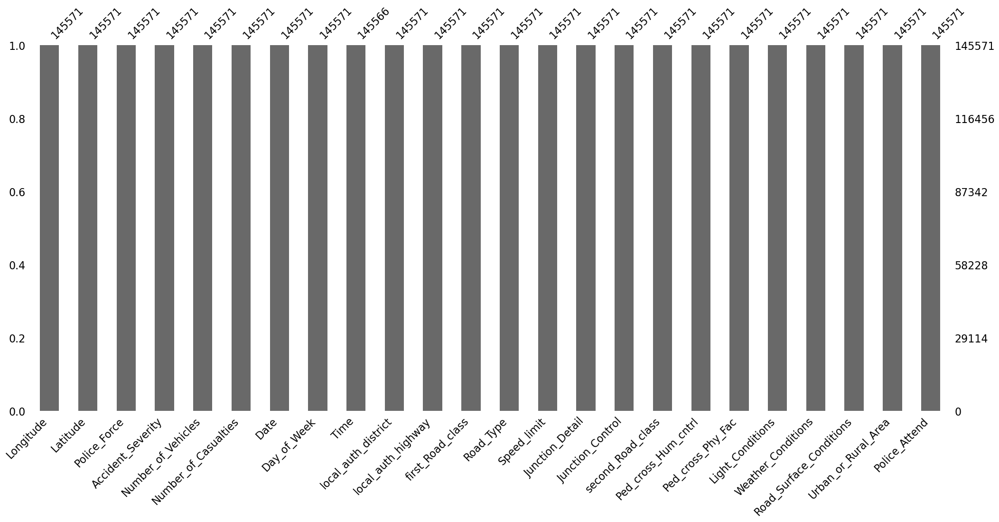

In [22]:
msno.bar(acc_subset)
plt.show()

> There are very few missing values. We will drop them in next few cells

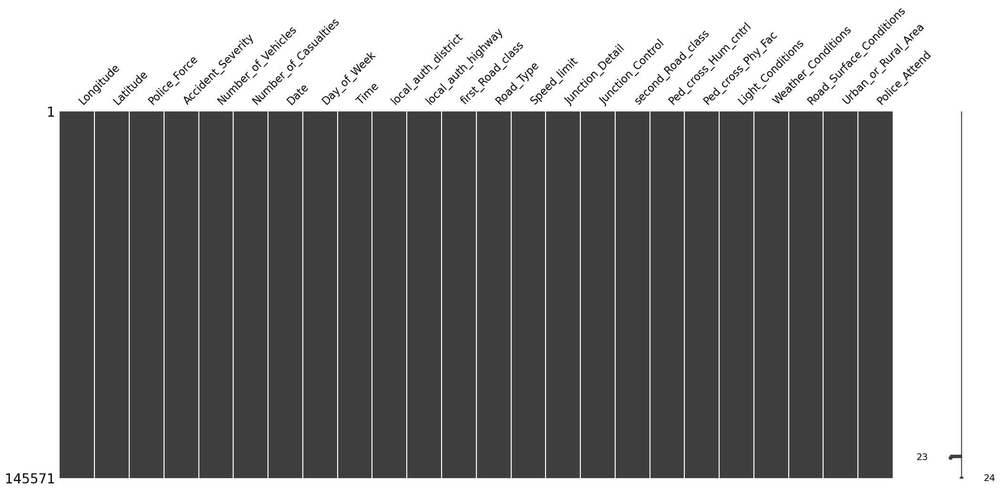

In [23]:
msno.matrix(acc_subset)
plt.show()

>  There is very less missng data

### Handling missing values

In [24]:
acc_subset.isnull().sum()

Longitude                  0
Latitude                   0
Police_Force               0
Accident_Severity          0
Number_of_Vehicles         0
Number_of_Casualties       0
Date                       0
Day_of_Week                0
Time                       5
local_auth_district        0
local_auth_highway         0
first_Road_class           0
Road_Type                  0
Speed_limit                0
Junction_Detail            0
Junction_Control           0
second_Road_class          0
Ped_cross_Hum_cntrl        0
Ped_cross_Phy_Fac          0
Light_Conditions           0
Weather_Conditions         0
Road_Surface_Conditions    0
Urban_or_Rural_Area        0
Police_Attend              0
dtype: int64

In [25]:
acc_subset.dropna(axis=0, inplace=True)
acc_subset.isnull().sum()

Longitude                  0
Latitude                   0
Police_Force               0
Accident_Severity          0
Number_of_Vehicles         0
Number_of_Casualties       0
Date                       0
Day_of_Week                0
Time                       0
local_auth_district        0
local_auth_highway         0
first_Road_class           0
Road_Type                  0
Speed_limit                0
Junction_Detail            0
Junction_Control           0
second_Road_class          0
Ped_cross_Hum_cntrl        0
Ped_cross_Phy_Fac          0
Light_Conditions           0
Weather_Conditions         0
Road_Surface_Conditions    0
Urban_or_Rural_Area        0
Police_Attend              0
dtype: int64

> We dropped missing rows as they were very few and we can see above there are no more missing values.

In [26]:
acc_subset = acc_subset.drop_duplicates()
acc_subset.shape

(145565, 24)

> we dropped few duplicate rows. As they might effect model performance.

### Checking for outliers using boxplot

<Axes: >

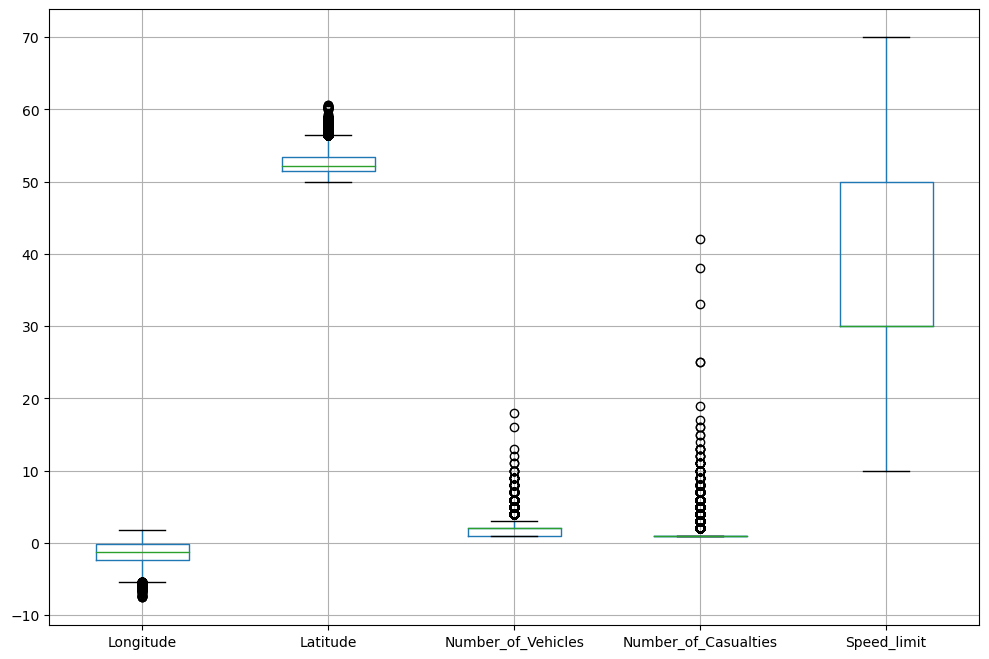

In [27]:
plt.figure(figsize=(12,8))
acc_subset.boxplot()

> There are few outliers in the column Number of Casualities, hence we are dropping them

In [28]:
acc_subset=acc_subset[acc_subset['Number_of_Casualties']<=20]

In [29]:
acc_subset.shape

(145560, 24)

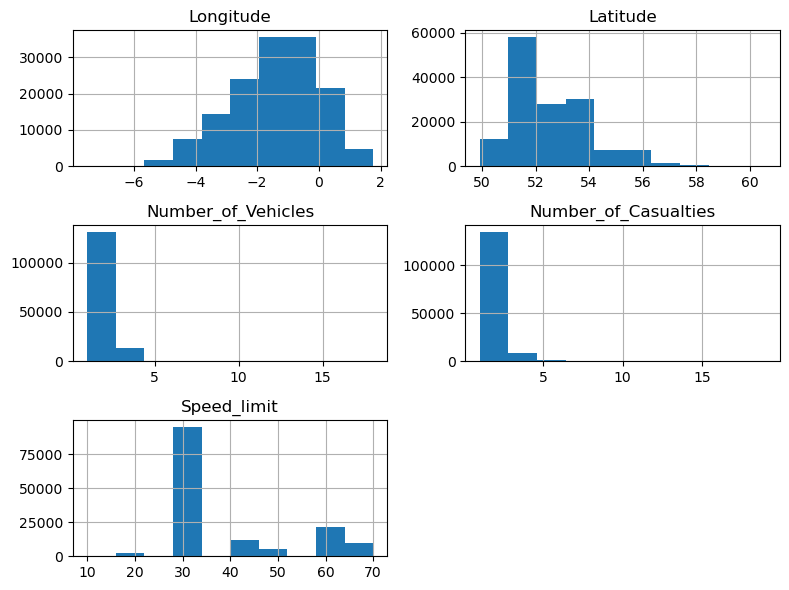

In [30]:
fig, ax = plt.subplots(1, 1, figsize=(8, 6))
acc_subset.hist(ax=ax)
plt.tight_layout()
plt.show()

## Visualizations

In [31]:
fig = px.scatter(acc_subset, x='Number_of_Vehicles', y='Number_of_Casualties')
fig.show()

> A scatter plot to visualize the relationship between the number of vehicles involved and the number of casualties in a dataset.

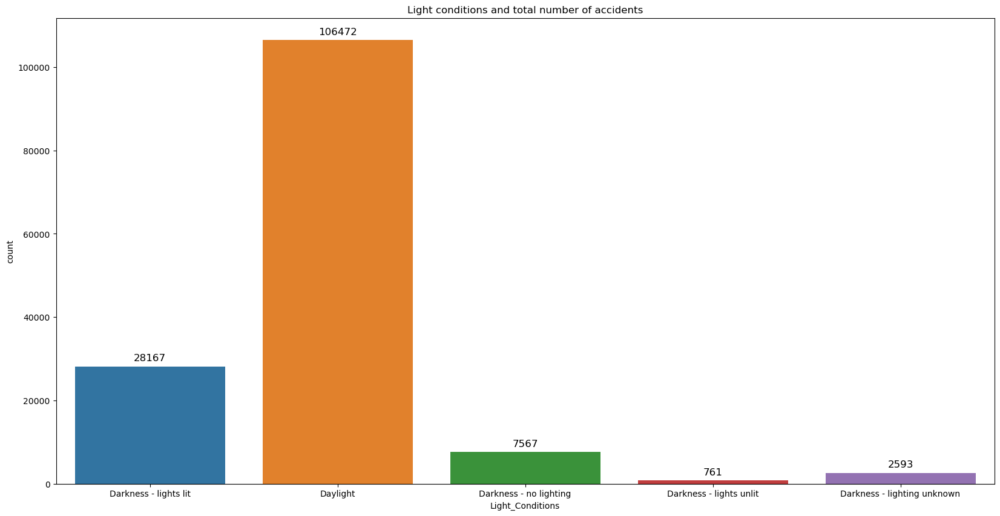

In [32]:
plt.figure(figsize=(20,10))

ax = sns.countplot(data=acc_subset, x="Light_Conditions")

for p in ax.patches:

    ax.annotate(f'{int(p.get_height())}', (p.get_x() + p.get_width() / 2., p.get_height()),

    ha='center', va='center', fontsize=12, color='black', xytext=(0, 10),

    textcoords='offset points')
plt.title("Light conditions and total number of accidents")
plt.show()

> A bar plot to visualize the distribution of total accident counts based on different light conditions. Each bar represents a unique light condition, and the height of the bar corresponds to the number of accidents under that condition. Also, Annotated each bar with the count for increased redability

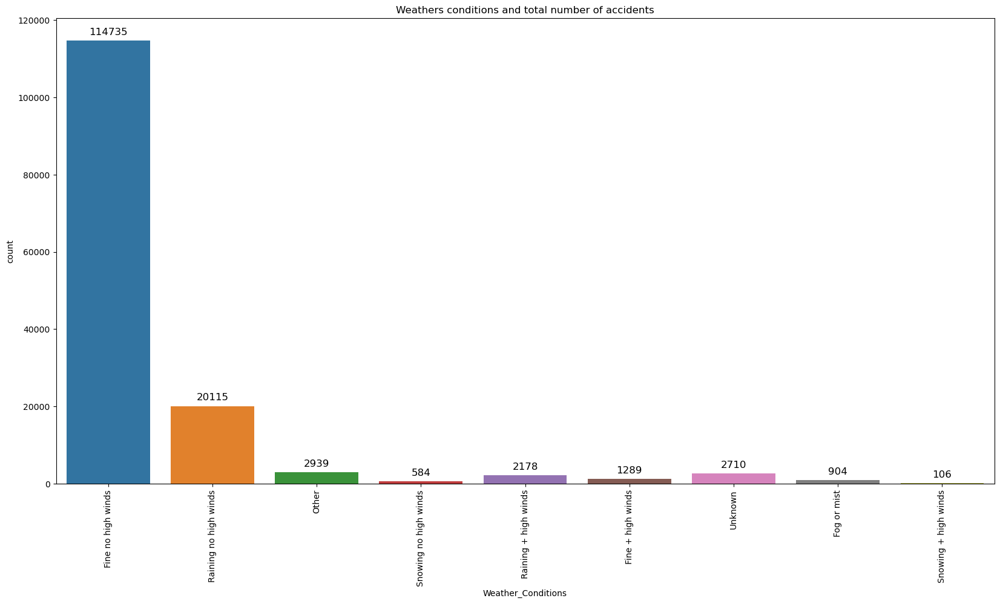

In [33]:
plt.figure(figsize=(20,10))
plt.xticks(rotation=90)
ax = sns.countplot(data=acc_subset, x="Weather_Conditions")

for p in ax.patches:
    ax.annotate(f'{int(p.get_height())}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=12, color='black', xytext=(0, 10),
                textcoords='offset points')
plt.title("Weathers conditions and total number of accidents")
plt.show()

> A bar plot to visualize the distribution of accident counts based on different weather conditions Each bar represents a unique weather condition, and the height of the bar corresponds to the number of accidents that occurred under that specific condition. Labels on the x-axis are rotated 90 degrees , and each bar is annotated with the count for clfor better readability.


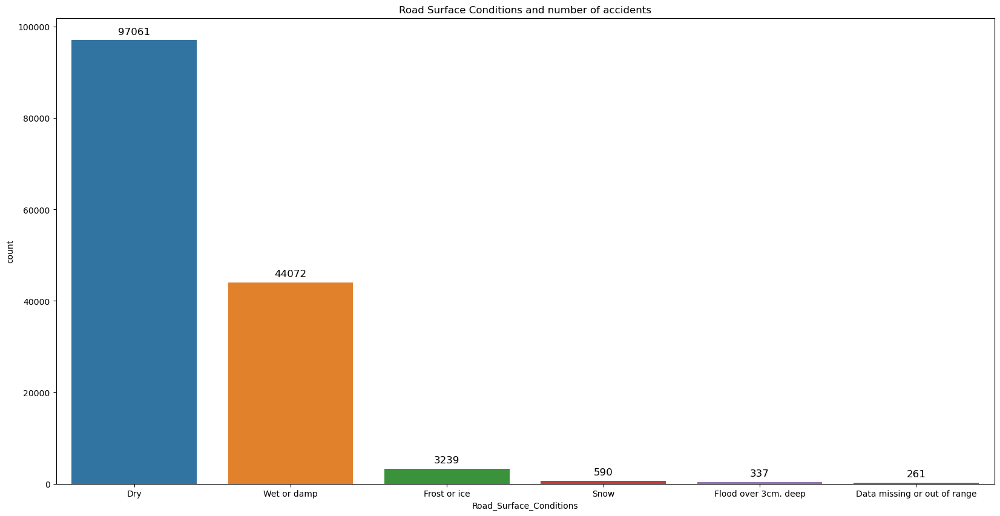

In [34]:
plt.figure(figsize=(20,10))
ax = sns.countplot(data=acc_subset,x='Road_Surface_Conditions')
for p in ax.patches:
    ax.annotate(f'{int(p.get_height())}', (p.get_x() + p.get_width() / 2, p.get_height()),
                ha='center', va='center', fontsize=12, color='black', xytext=(0, 10),
                textcoords='offset points')
plt.title("Road Surface Conditions and number of accidents")
plt.show()

> A bar plot to visualize the distribution of accident counts based on different Road surface conditions.Each bar represents a unique road surface condition, and the height of the bar corresponds to the number of accidents that occurred under that specific condition.Each bar is annotated with the count for clfor better readability.

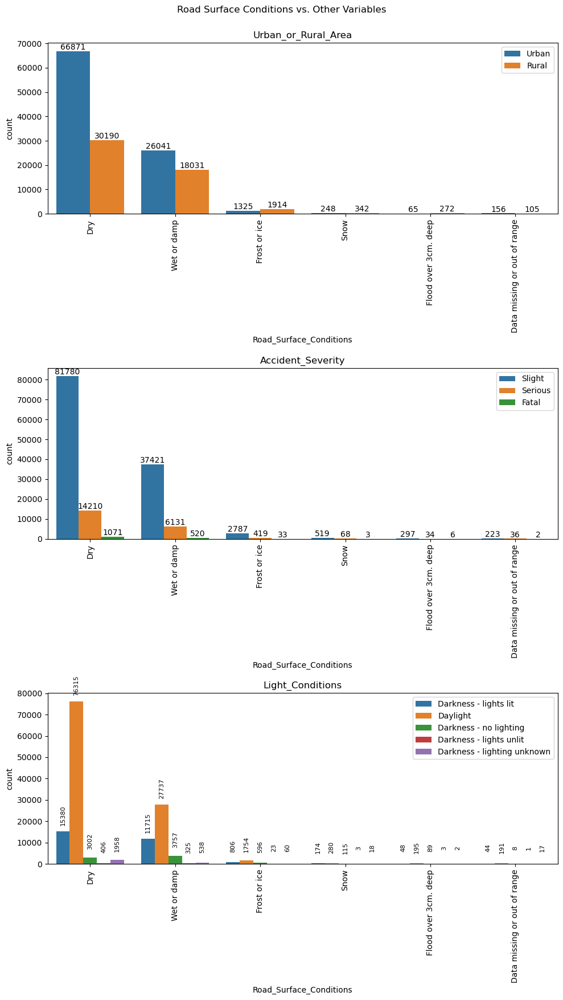

In [35]:
fig, axs = plt.subplots(nrows=3, ncols=1, figsize=(10, 17.5))
variables = ['Urban_or_Rural_Area', 'Accident_Severity', "Light_Conditions"]

for i, var in enumerate(variables):
    ax = axs[i]
    sns.countplot(data=acc_subset, x='Road_Surface_Conditions', hue=var, ax=ax)
    ax.set_title(var)
    ax.legend(loc='upper right')
    
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
    if i==2:
        for p in ax.patches:
            ax.annotate(f'{int(p.get_height())}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=8, color='black', xytext=(0, 20),
                textcoords='offset points', rotation=90)
    else:    
        for p in ax.patches:
            ax.annotate(f'{int(p.get_height())}', (p.get_x() + p.get_width() / 2., p.get_height()),
                    ha='center', va='center', fontsize=10, color='black', xytext=(0, 5),
                    textcoords='offset points')
    

fig.suptitle('Road Surface Conditions vs. Other Variables',y=1)

fig.tight_layout()

plt.show()


> A set of subplots arranged in a 3x1 grid to compare 'Road_Surface_Conditions' with three different variables, 'Urban_or_Rural_Area,' 'Accident_Severity,' and 'Light_Conditions'.
<br/>
For each subplot:<br/>
there is a count plot, showing the distribution of 'Road_Surface_Conditions' with hue-based separation by the variable.<br/>
Rotate x-axis labels for readability.<br/>
Annotate each bar with the count .<br/>
tight_layout make sures sub plots don't overlap


In [36]:
check_cols=['Accident_Severity', 'Number_of_Vehicles', 'Number_of_Casualties',
                   'first_Road_class', 'Road_Type', 'Speed_limit', 'Junction_Detail', 'Junction_Control',
                   'second_Road_class', 'Light_Conditions', 'Weather_Conditions', 'Road_Surface_Conditions',
                   'Urban_or_Rural_Area', 'Police_Attend']

for feature in check_cols:
    var_value = acc_subset[feature].value_counts().reset_index()
    var_value.columns = ['Values', 'Frequency']

    fig = px.bar(var_value, x='Values', y='Frequency', text='Frequency', title=" ".join(feature.split("_")))
    fig.update_xaxes(categoryorder='total ascending')
    fig.update_traces(texttemplate='%{text}', textposition='outside')

    fig.update_layout(
        xaxis_title=feature,
        yaxis_title='Frequency',
        xaxis_tickangle=-45,
        showlegend=False
    )

    fig.show()


> A series of bar plots to visualize the frequency distribution of various features in the dataset.<br/>
Features included for analysis are: Accident_Severity, Number_of_Vehicles, Number_of_Casualties, First_Road_Class, Road_Type, Speed_Limit, Junction_Detail, Junction_Control, Second_Road_Class, Light_Conditions, Weather_Conditions, Road_Surface_Conditions, Urban_or_Rural_Area, and Police_Attend.<br/>
For each feature:<br/>
Created a bar plot using Plotly, where the x-axis represents the frequency distribution of unique values and the y-axis represents the frequency of accidents.


### Observations
- Most of the accidents are not fatal or death-causing.
- In most accidents, 2 vehicles were involved, followed by 1 vehicle.
- In most accidents, number of casualties are 1.
- Most accidents occurred on single-carriageway roads i.e. the roads where there is flow in both directions but no divider in between.
- Most accidents occurred at the speed limit of 30.
- Most accidents occurred at the junctions that are not supervised by traffic lights. Hence, it is advised to make most junctions supervised with traffic lights.
- Most accidents occurred at Day times, as we know most traffic is seen in the mornings.
- Most of the accidents occurred when weather conditions were normal with no high winds or rain.
- Most accidents occurred in Urban areas.

### Running bar chart 

In [37]:
acc_subset['Date'] = pd.to_datetime(acc_subset['Date'], format='%d/%m/%Y')

In [38]:
agg_data = acc_subset.copy()

# Converting relevant columns to numeric in the 'agg_data' DataFrame
numeric_columns = ['Number_of_Casualties']
agg_data[numeric_columns] = agg_data[numeric_columns].apply(pd.to_numeric, errors='coerce')

agg_data = agg_data.groupby(['Date', 'Day_of_Week'])['Number_of_Casualties'].sum().unstack(fill_value=0)

agg_data = agg_data.cumsum()

for x in list(agg_data.columns):
    agg_data[x] = agg_data[x].astype(int)
# Creating the running bar chart
bcr.bar_chart_race(
    df=agg_data,
    filename='running_bar_chart.mp4',
    orientation='h',
    sort='desc',
    label_bars=True
)


In [39]:
Video("running_bar_chart.mp4")

> The above running bar chart visually illustrates the cumulative change in the number of casualties over time on different days of a week, providing insights into trends and patterns in the data.

In [40]:
fig = px.density_heatmap(acc_subset, x='Police_Force', y='Accident_Severity', title="Accident Severity Heatmap")
fig.update_layout(
    width=1000,
    height=600,
)
fig.show()

> Above heatmap is accident severity vs various Police Force for total number of accidents in each police force

In [41]:
df_date = acc_subset.groupby('Date').size().reset_index(name='Count')
unique_dates = pd.date_range(start=df_date['Date'].min(), end=df_date['Date'].max())
s = pd.Series(df_date['Count'].tolist(), index=unique_dates)
s

2012-01-01    249
2012-01-02    243
2012-01-03    329
2012-01-04    382
2012-01-05    393
             ... 
2012-12-27    290
2012-12-28    197
2012-12-29    202
2012-12-30    213
2012-12-31    257
Freq: D, Length: 366, dtype: int64

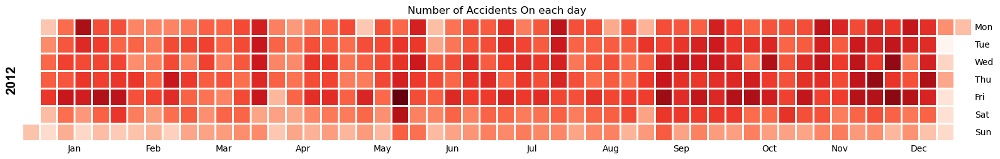

In [42]:
calmap.calendarplot(s, fig_kws={'figsize': (16,10)}, yearlabel_kws={'color':'black', 'fontsize':15}, subplot_kws={'title':'Number of Accidents On each day'})
plt.show()

> Above calendar map shows density of number of accidents on each day of the year

In [43]:
df_date = acc_subset.groupby('Date').size().reset_index(name='Count')
df_date['Date'] = pd.to_datetime(df_date['Date'])
df_date = df_date.set_index('Date')

# Create a calendar heatmap with hover text using Plotly
fig = go.Figure(data=go.Heatmap(
    z=df_date['Count'],
    x=df_date.index.day,
    y=df_date.index.month,
    colorscale='plasma',
    hovertext=['Date: {}<br>Accidents: {}'.format(date.strftime('%Y-%m-%d'), count) for date, count in zip(df_date.index, df_date['Count'])]
))

# Customize the title and layout
fig.update_layout(
    title='Number of Accidents On Each Day',
    xaxis_title='Day',
    yaxis_title='Month',
    width=1000,
    height=600
)

# Show the plot
fig.show()

> Above is also a calendar map shows density of number of accidents on each day of the year and when we hover mouse it will also show number of accidents on that day

In [44]:
import plotly.express as px

fig = px.scatter(
    Acc_df1,
    x='Number_of_Vehicles',
    y='Number_of_Casualties',
    color='Accident_Severity',
    title="Scatter Plot of Number of Vehicles vs. Number of Casualties",
    labels={'Number_of_Vehicles': 'Number of Vehicles', 'Number_of_Casualties': 'Number of Casualties'},
    color_continuous_scale='Rainbow'
)

fig.update_layout(
    xaxis_title="Number of Vehicles",
    yaxis_title="Number of Casualties",
)

fig.show()


> Above is a scatter plot which shows Number of Vehicles vs Number of Casualities and there Accident Severity

In [45]:
mapping = {
    'Fatal': 3,
    'Serious': 2,
    'Slight': 1
}

sub1 = acc_subset

In [46]:
sub1['Number_of_Casualties'] = sub1['Number_of_Casualties'].apply(lambda x: mapping.get(x, x))

In [47]:
sub1.head()

,Longitude,Latitude,Police_Force,Accident_Severity,Number_of_Vehicles,Number_of_Casualties,Date,Day_of_Week,Time,local_auth_district,...,Junction_Detail,Junction_Control,second_Road_class,Ped_cross_Hum_cntrl,Ped_cross_Phy_Fac,Light_Conditions,Weather_Conditions,Road_Surface_Conditions,Urban_or_Rural_Area,Police_Attend
0,-0.169101,51.493429,Metropolitan Police,Slight,2,1,2012-01-19,Thursday,20:35,Kensington and Chelsea,...,Crossroads,Auto traffic signal,C,None within 50 metres,Pedestrian phase at traffic signal junction,Darkness - lights lit,Fine no high winds,Dry,Urban,Yes
1,-0.200838,51.517931,Metropolitan Police,Slight,2,1,2012-01-04,Wednesday,17:00,Westminster,...,T or staggered junction,Give way or uncontrolled,Unclassified,None within 50 metres,No physical crossing facilities within 50 metres,Darkness - lights lit,Fine no high winds,Dry,Urban,Yes
2,-0.188636,51.487618,Metropolitan Police,Slight,2,1,2012-01-10,Tuesday,10:07,Kensington and Chelsea,...,Crossroads,Give way or uncontrolled,Unclassified,None within 50 metres,"Pelican, puffin, toucan or similar non-junctio...",Daylight,Fine no high winds,Dry,Urban,Yes
3,-0.200259,51.514325,Metropolitan Police,Slight,1,1,2012-01-18,Wednesday,12:20,Kensington and Chelsea,...,T or staggered junction,Give way or uncontrolled,Unclassified,None within 50 metres,No physical crossing facilities within 50 metres,Daylight,Fine no high winds,Dry,Urban,Yes
4,-0.183773,51.497614,Metropolitan Police,Slight,1,1,2012-01-17,Tuesday,20:24,Kensington and Chelsea,...,T or staggered junction,Give way or uncontrolled,Unclassified,None within 50 metres,No physical crossing facilities within 50 metres,Darkness - lights lit,Fine no high winds,Dry,Urban,Yes


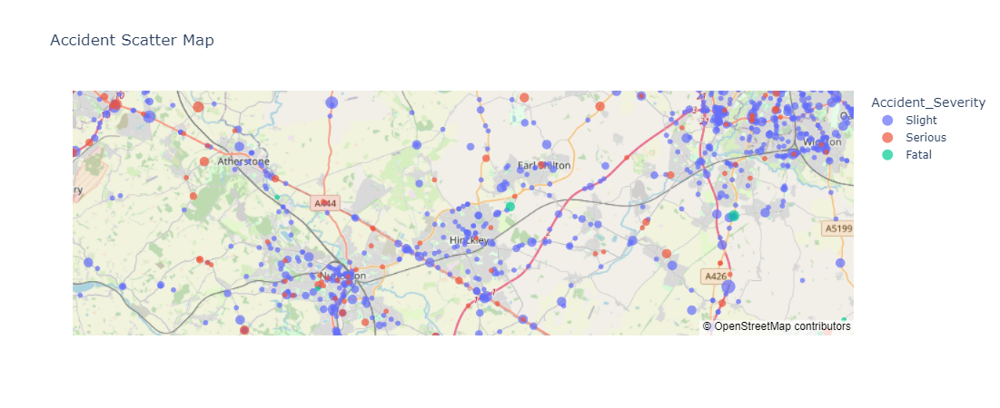

In [48]:
import plotly.express as px

fig = px.scatter_mapbox(sub1, lat='Latitude', lon='Longitude', color='Accident_Severity',
                        size='Number_of_Casualties',
                        mapbox_style="open-street-map",  # Choose the map style you prefer
                        title="Accident Scatter Map")

# Customize the map layout
fig.update_mapboxes(zoom=10)  # Adjust the zoom level as needed
fig.update_layout(
    mapbox=dict(center={'lon': sub1['Longitude'].mean(), 'lat': sub1['Latitude'].mean()}),  # Set the initial map center
)

fig.show()


> Above is a map which plots accidents based on latitute and longitude also plotting severity of each accident and increasing or decreasing size of point based on number of casualities

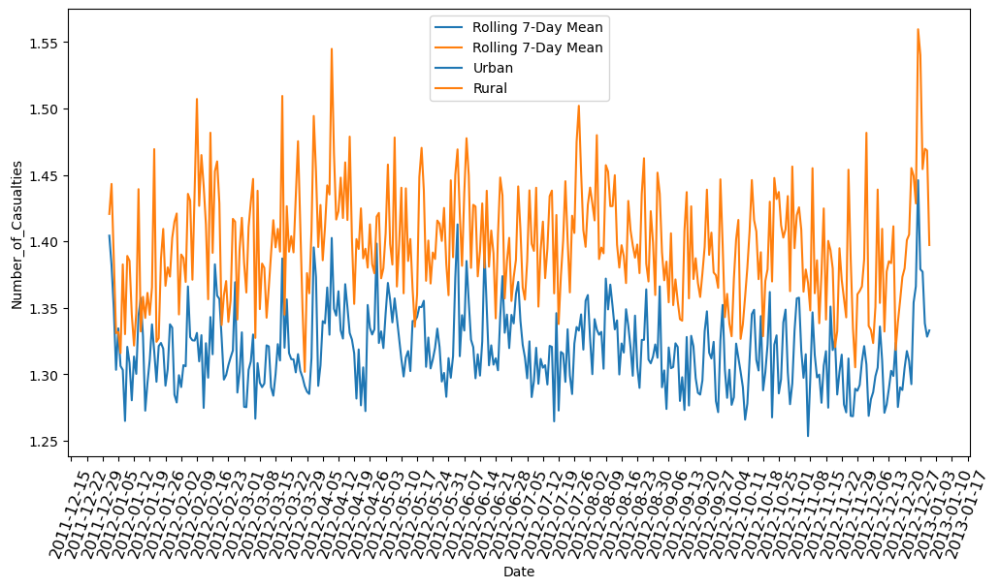

In [49]:
plt.figure(figsize=(12, 6))
window_size = 7
rolling_mean = acc_subset['Number_of_Casualties'].rolling(window=window_size).mean()
sns.lineplot(data=acc_subset, x='Date', y=rolling_mean, label=f'Rolling {window_size}-Day Mean',  hue='Urban_or_Rural_Area', err_style=None)
plt.xticks(rotation=70)
plt.xticks(fontsize=12) 
plt.gca().xaxis.set_major_locator(plt.MultipleLocator(7))
plt.legend()
plt.show()

>Line plot between Rural and Urban accidents using windows rolling function

## Implementation of ML models using pipelines

In [50]:
from sklearn.preprocessing import LabelEncoder,StandardScaler,OneHotEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import SelectFromModel
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
import xgboost as xgb
from sklearn.metrics import accuracy_score,roc_auc_score
from sklearn.compose import ColumnTransformer

In [51]:
processed_acc_subset = acc_subset.copy()

# Encoding categorical variables
categorical_columns = ['Police_Force','Day_of_Week','local_auth_district', 'local_auth_highway', 'first_Road_class',
       'Road_Type', 'Junction_Detail', 'Junction_Control',
       'second_Road_class', 'Ped_cross_Hum_cntrl', 'Ped_cross_Phy_Fac',
       'Light_Conditions', 'Weather_Conditions', 'Road_Surface_Conditions',
       'Urban_or_Rural_Area', 'Police_Attend','Accident_Severity'] 

label_encoders = {}

# Appling label encoding to categorical columns
for column in categorical_columns:
    le = LabelEncoder()
    processed_acc_subset[column] = le.fit_transform(processed_acc_subset[column])
    label_encoders[column] = le

# Extracted date and time features
processed_acc_subset['Date'] = pd.to_datetime(processed_acc_subset['Date'])
processed_acc_subset['hour'] = processed_acc_subset['Date'].dt.hour
processed_acc_subset['month'] = processed_acc_subset['Date'].dt.month
processed_acc_subset['day'] = processed_acc_subset['Date'].dt.day
processed_acc_subset['year'] = processed_acc_subset['Date'].dt.year

# Droping original date and time columns
processed_acc_subset.drop(columns=['Date', 'Time'], inplace=True)

In [52]:
# Defining the features and target variable
X = processed_acc_subset.drop(columns=['Accident_Severity'])
y = processed_acc_subset['Accident_Severity']

clf = RandomForestClassifier(n_estimators=100, random_state=42)

clf.fit(X, y)

importances = clf.feature_importances_

# Selecting features with importance above a threshold
sfm = SelectFromModel(clf, threshold=0.05)
sfm.fit(X, y)

selected_features = X.columns[sfm.get_support()]
print(selected_features)


Index(['Longitude', 'Latitude', 'Day_of_Week', 'local_auth_district',
       'local_auth_highway', 'month', 'day'],
      dtype='object')


In [53]:
X = processed_acc_subset.drop(columns=['Accident_Severity'])
y = processed_acc_subset['Accident_Severity']

# Spliting the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [54]:
#pipeline for Linear Regression
lr_pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('classifier', LogisticRegression())
])

lr_pipeline.fit(X_train, y_train)

lr_predictions = lr_pipeline.predict(X_test)
lr_accuracy = accuracy_score(y_test, lr_predictions)

In [55]:
#pipeline for Decision Tree Classifier
dt_pipeline = Pipeline([
    ('classifier', DecisionTreeClassifier())
])

dt_pipeline.fit(X_train, y_train)

dt_predictions = dt_pipeline.predict(X_test)
dt_accuracy = accuracy_score(y_test, dt_predictions)

In [56]:
#pipeline for Random Forest Classifier
rf_pipeline = Pipeline([
    ('classifier', RandomForestClassifier())
])

rf_pipeline.fit(X_train, y_train)

rf_predictions = rf_pipeline.predict(X_test)
rf_accuracy = accuracy_score(y_test, rf_predictions)

In [57]:
#pipeline for XGBoost
xgb_pipeline = Pipeline([
    ('classifier', xgb.XGBClassifier())
])

xgb_pipeline.fit(X_train, y_train)

xgb_predictions = xgb_pipeline.predict(X_test)
xgb_accuracy = accuracy_score(y_test, xgb_predictions)


In [58]:
print(f'Logistic Regression Accuracy: {lr_accuracy}')
print(f'Decision Tree Accuracy: {dt_accuracy}')
print(f'Random Forest Accuracy: {rf_accuracy}')
print(f'XGBoost Accuracy: {xgb_accuracy}')

Logistic Regression Accuracy: 0.8436727122835944
Decision Tree Accuracy: 0.7326188513327837
Random Forest Accuracy: 0.8414743061280572
XGBoost Accuracy: 0.8428826600714482


In [59]:
X = processed_acc_subset.drop(columns=['Accident_Severity'])
y = processed_acc_subset['Accident_Severity']

# categorical and numerical columns
categorical_cols = ['Police_Force', 'Day_of_Week', 'local_auth_district', 'local_auth_highway', 'first_Road_class',
                   'Road_Type', 'Junction_Detail', 'Junction_Control',
                   'second_Road_class', 'Ped_cross_Hum_cntrl', 'Ped_cross_Phy_Fac',
                   'Light_Conditions', 'Weather_Conditions', 'Road_Surface_Conditions',
                   'Urban_or_Rural_Area', 'Police_Attend']
numerical_cols = ['hour', 'month', 'day', 'year']


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#preprocessor to handle encoding and scaling
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numerical_cols),  # Standardize numerical features
        ('cat', OneHotEncoder(), categorical_cols)  # One-hot encode categorical features
    ])

#pipeline for Logistic Regression
lr_pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('classifier', LogisticRegression())
])

lr_pipeline.fit(X_train, y_train)

lr_predictions = lr_pipeline.predict(X_test)
lr_accuracy = accuracy_score(y_test, lr_predictions)

#pipeline for Decision Tree Classifier
dt_pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('classifier', DecisionTreeClassifier())
])

dt_pipeline.fit(X_train, y_train)

dt_predictions = dt_pipeline.predict(X_test)
dt_accuracy = accuracy_score(y_test, dt_predictions)

#pipeline for Random Forest Classifier
rf_pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('classifier', RandomForestClassifier())
])

rf_pipeline.fit(X_train, y_train)

rf_predictions = rf_pipeline.predict(X_test)
rf_accuracy = accuracy_score(y_test, rf_predictions)

#pipeline for XGBoost
xgb_pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('classifier', xgb.XGBClassifier())
])

xgb_pipeline.fit(X_train, y_train)

xgb_predictions = xgb_pipeline.predict(X_test)
xgb_accuracy = accuracy_score(y_test, xgb_predictions)

print(f'Logistic Regression Accuracy: {lr_accuracy}')
print(f'Decision Tree Accuracy: {dt_accuracy}')
print(f'Random Forest Accuracy: {rf_accuracy}')
print(f'XGBoost Accuracy: {xgb_accuracy}')


Logistic Regression Accuracy: 0.8437070623797747
Decision Tree Accuracy: 0.7447100851882386
Random Forest Accuracy: 0.8351882385270679
XGBoost Accuracy: 0.8433979115141522


In [60]:
from interpret import set_visualize_provider
from interpret.provider import InlineProvider
from interpret import show
set_visualize_provider(InlineProvider())

In [61]:
from interpret.glassbox import ExplainableBoostingClassifier

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_train_transformed = preprocessor.fit_transform(X_train)

ebm = ExplainableBoostingClassifier()
ebm.fit(X_train_transformed, y_train)

X_test_transformed = preprocessor.transform(X_test)

ebm_predictions = ebm.predict(X_test_transformed)

ebm_accuracy = accuracy_score(y_test, ebm_predictions)

print(f'EBM Accuracy: {ebm_accuracy}')

EBM Accuracy: 0.8437070623797747


In [62]:
#show(ebm.explain_global())

In [63]:
# from sklearn.svm import SVC
# from sklearn.naive_bayes import MultinomialNB

# # Create a pipeline for Support Vector Machine (SVM)
# svm_pipeline = Pipeline([
#     ('preprocessor', preprocessor),
#     ('classifier', SVC())
# ])

# # Fit the SVM model
# svm_pipeline.fit(X_train, y_train)

# # Make predictions and calculate accuracy for SVM
# svm_predictions = svm_pipeline.predict(X_test)
# svm_accuracy = accuracy_score(y_test, svm_predictions)


In [64]:
# Create a pipeline for Naive Bayes (Multinomial Naive Bayes)
# from sklearn.naive_bayes import MultinomialNB

# nb_pipeline = Pipeline([
#     ('preprocessor', preprocessor),
#     ('classifier', MultinomialNB())
# ])

# # Fit the Naive Bayes model
# nb_pipeline.fit(X_train, y_train)

# # Make predictions and calculate accuracy for Naive Bayes
# nb_predictions = nb_pipeline.predict(X_test)
# nb_accuracy = accuracy_score(y_test, nb_predictions)


In [65]:
# Print the accuracies
# print(f'SVM Accuracy: {svm_accuracy}')
# print(f'Naive Bayes Accuracy: {nb_accuracy}')